# FURTHER ANALYSIS

In [1]:
# Load packages 
import scanpy as sc
import anndata as ad
import os
import pandas as pd
import matplotlib.pyplot as plt
import scmoib
import numpy as np
import tqdm
import episcanpy as epi

In [2]:
# figure settings
sc.set_figure_params(scanpy=True, dpi=200, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')

## Load the processed data

DATADIR = "/storage/groups/ce01/workspace/mobisc_anna/processed_datasets/share_seq_brain"
#%ls $DATADIR
files = [os.path.join(DATADIR, 'old_anndata_brain_share_seq_geneactivity_rna_merged.h5ad')]

int_files = ['liger_jnmf_integration.h5ad', 
             'scJoint_integration.h5ad', 
             'seurat_cca_integration.h5ad', 
             'seurat_rpca_integration.h5ad', 
             'scalex.h5ad', 
             'scot.h5ad']

DATADIR = "/storage/groups/ce01/workspace/mobisc_anna/integrated_outputs/share_seq_brain_shared_genes_full"
#%ls $DATADIR
for i in int_files:
    files.append(os.path.join(DATADIR, i))
    
ids = ['unintegrated', 'liger', 'scjoint', 'seurat_cca', 'seurat_rpca', 'scalex', 'scot']
modes = ['raw', 'comps', 'comps', 'count', 'count', 'graph', 'comps']
col = ['broad_annotations'] * 7
reps = [None, 'X_inmf_embedding', 'X_scjoint_embedding', None, None, None, 'scot_embedding']
my_obj = scmoib.tl.MetricsCalculator()
adata_list = []
assert len(ids) == len(modes) == len(col) == len(reps)

In [3]:
DATADIR = "/mnt/znas/icb_zstore01/groups/ce01/workspace/mobisc_anna/processed_datasets/PBMC_10X/"

files = [os.path.join(DATADIR, 'old_anndata_pbmc_10x_processed_merged_rna_first_full_feature.h5ad')]

int_files = ['PBMC_10x/liger_jnmf_integration.h5ad',
             'PBMC_10x/scJoint.h5ad',
             'PBMC_10x/scot.h5ad',
             'old_files/scalex/RNA-ATAC_pbmc_10x_scalex_processed_full_feature.h5ad', 
             'old_files/bindsc/pbmc_10x_bindsc_rna_first_full_feature.h5ad', 
             'old_files/seurat_cca/pbmc_10x_seurat_cca_rna_first.h5ad',
             'old_files/seurat_rpca/pbmc_10x_seurat_rpca_rna_first.h5ad']

DATADIR = "/storage/groups/ce01/workspace/mobisc_anna/integrated_outputs/"

for i in int_files:
    files.append(os.path.join(DATADIR, i))
    
ids = ['unintegrated', 'liger', 'scjoint', 'scot', 'scalex', 'bindsc', 'seurat_cca', 'seurat_rpca']
modes = ['raw', 'comps', 'comps', 'comps', 'graph', 'count', 'count', 'count']
col = ['broad cell types'] * 8
reps = [None, 'X_inmf_embedding', 'X_scjoint_embedding', 'scot_embedding', None, None, None, None]
my_obj = scmoib.tl.MetricsCalculator()
adata_list = []
assert len(ids) == len(modes) == len(col) == len(reps)

In [4]:
%%time


for i in tqdm.tqdm(files):
    pbmc = ad.read(i)
    adata_id = ids[files.index(i)]
    clust_id = 'louvain'
    ct_id = col[files.index(i)]
    bc_list = list(pbmc.obs.index)
    bc_list1 = bc_list[:len(bc_list) // 2]
    bc_list2 = bc_list[len(bc_list) // 2:]
    mode = modes[files.index(i)]
    rep = reps[files.index(i)]
    scmoib.pp.check_anndata(pbmc, ct_id, mode=mode, use_rep=rep)
    print('-' * 10)
    try:
        my_obj.node_metrics(pbmc, adata_id, bc_list1, bc_list2, ct_id, n_jobs=8)
        my_obj.spec_dist(pbmc, adata_id=adata_id, n_metr=10)
    except:
        print("no graph for spec dist")
    print('2')
    try:
        my_obj._accuracy_paired_omics(pbmc, adata_id, bc_list1, bc_list2, 'omic_batch', clust_id)
        my_obj._accuracy_paired_omics_per_cell_type(pbmc, bc_list1, bc_list2, 
                                                    'omic_batch', clust_id, ct_id)
        my_obj.ami(pbmc, adata_id, ct_id, clust_id)
        my_obj.ari(pbmc, adata_id, ct_id, clust_id)
        my_obj.nmi(pbmc, adata_id, ct_id, clust_id)
        my_obj.homogeneity(pbmc, adata_id, ct_id, clust_id)
    
    except ValueError as err:
        print(f"Trouble with {adata_id}")
        print(err.args[0])
    print('3')
    my_obj._graph_connectivity(pbmc, adata_id, ct_id)
    my_obj._average_dist_between_matching_barcodes(pbmc, adata_id, bc_list1, bc_list2, metric='cosine')
    my_obj.silhouette(pbmc, adata_id, cell_label=ct_id, embed='X_umap')
    my_obj.silhouette_batch(pbmc, adata_id, batch_key='omic_batch', cell_label=ct_id, embed='X_umap')
    my_obj.isolated_labels(pbmc, adata_id, 'omic_batch', ct_id, embed='X_umap')
    adata_list.append(pbmc)
my_obj.get_df()

  0%|                                                     | 0/8 [00:00<?, ?it/s]

Running pre-flight check


Clustering...
step 0
got 23 at resolution 1.5
step 1
got 15 at resolution 0.75
step 2
got 11 at resolution 0.375
step 3
got 7 at resolution 0.1875
step 4
got 11 at resolution 0.28125
step 5
got 10 at resolution 0.234375
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


no graph for spec dist
2
3


 12%|█████▏                                   | 1/8 [20:26<2:23:03, 1226.25s/it]

Running pre-flight check
Clustering...
step 0
got 22 at resolution 1.5
step 1
got 17 at resolution 0.75
step 2
got 13 at resolution 0.375
step 3
got 9 at resolution 0.1875
step 4
got 13 at resolution 0.28125
step 5
got 12 at resolution 0.234375
step 6
got 10 at resolution 0.2109375
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


2
3


 25%|██████████▎                              | 2/8 [38:42<1:54:57, 1149.52s/it]

Running pre-flight check
Clustering...
step 0
got 17 at resolution 1.5
step 1
got 13 at resolution 0.75
step 2
got 9 at resolution 0.375
step 3
got 10 at resolution 0.5625
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


2
3


 38%|███████████████▍                         | 3/8 [55:40<1:30:49, 1089.89s/it]

Running pre-flight check
Clustering...
step 0
got 30 at resolution 1.5
step 1
got 18 at resolution 0.75
step 2
got 11 at resolution 0.375
step 3
got 7 at resolution 0.1875
step 4
got 11 at resolution 0.28125
step 5
got 9 at resolution 0.234375
step 6
got 10 at resolution 0.2578125
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


2
3


 50%|███████████████████▌                   | 4/8 [1:12:37<1:10:43, 1060.76s/it]

Running pre-flight check
Clustering...
step 0
got 18 at resolution 1.5
step 1
got 13 at resolution 0.75
step 2
got 8 at resolution 0.375
step 3
got 11 at resolution 0.5625
step 4
got 10 at resolution 0.46875
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


2
3


 62%|██████████████████████████▎               | 5/8 [1:22:31<44:37, 892.66s/it]

Running pre-flight check


Clustering...
step 0
got 21 at resolution 1.5
step 1
got 16 at resolution 0.75
step 2
got 11 at resolution 0.375
step 3
got 8 at resolution 0.1875
step 4
got 9 at resolution 0.28125
step 5
got 11 at resolution 0.328125
step 6
got 9 at resolution 0.3046875
step 7
got 11 at resolution 0.31640625
step 8
got 9 at resolution 0.310546875
step 9
got 10 at resolution 0.3134765625
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


2
3


 75%|███████████████████████████████▌          | 6/8 [1:31:49<25:57, 778.89s/it]

Running pre-flight check


Clustering...
step 0
got 21 at resolution 1.5
step 1
got 13 at resolution 0.75
step 2
got 9 at resolution 0.375
step 3
got 12 at resolution 0.5625
step 4
got 11 at resolution 0.46875
step 5
got 10 at resolution 0.421875
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


2
3


 88%|████████████████████████████████████▊     | 7/8 [1:38:49<11:01, 661.48s/it]

Running pre-flight check


Clustering...
step 0
got 21 at resolution 1.5
step 1
got 16 at resolution 0.75
step 2
got 11 at resolution 0.375
step 3
got 8 at resolution 0.1875
step 4
got 9 at resolution 0.28125
step 5
got 10 at resolution 0.328125
----------


Test run information:
CPU: 8 cores
Wall time: 6 minutes
RAM: 4 GB(?)
Number of barcode pairs: 11k


2
3


100%|██████████████████████████████████████████| 8/8 [1:46:02<00:00, 795.26s/it]

CPU times: user 3h 28min 36s, sys: 1h 39min 46s, total: 5h 8min 23s
Wall time: 1h 46min 2s


,conn_ratio,accuracy,AMI,ARI,NMI,homogeneity,graph connectivity broad cell types,pairwise_distance,sil_global,sil_clus,il_sil,il_clus,spec_dist_10
unintegrated,0.0,0.000000,0.601217,0.421081,0.601592,0.615105,0.499798,0.761411,0.492961,0.138951,NaN,NaN,NaN
liger,1.0,0.700873,0.657590,0.667749,0.657916,0.665790,0.917530,0.761411,0.553058,0.628724,NaN,NaN,0.816577
scjoint,1.0,0.999909,0.733410,0.682628,0.733663,0.743899,0.738926,0.761411,0.582869,0.995663,NaN,NaN,0.941321
scot,1.0,0.775746,0.695190,0.675156,0.695468,0.732539,0.950484,0.761411,0.625343,0.725484,NaN,NaN,0.762917
scalex,1.0,0.388737,0.666833,0.482170,0.667135,0.707853,0.988257,0.705320,0.578549,0.637460,NaN,NaN,0.875036
bindsc,1.0,0.010280,0.629792,0.457215,0.630131,0.661708,0.936445,0.687280,0.501753,0.176430,NaN,NaN,0.398853
seurat_cca,1.0,0.849163,0.729525,0.646358,0.729793,0.710242,0.979320,0.837083,0.627034,0.758343,NaN,NaN,0.938760
seurat_rpca,1.0,0.701055,0.635951,0.578401,0.636312,0.621872,0.966974,0.890710,0.580121,0.650131,NaN,NaN,0.836273


In [5]:
df = my_obj.get_df()
df

,conn_ratio,accuracy,AMI,ARI,NMI,homogeneity,graph connectivity broad cell types,pairwise_distance,sil_global,sil_clus,il_sil,il_clus,spec_dist_10
unintegrated,0.0,0.000000,0.601217,0.421081,0.601592,0.615105,0.499798,0.761411,0.492961,0.138951,NaN,NaN,NaN
liger,1.0,0.700873,0.657590,0.667749,0.657916,0.665790,0.917530,0.761411,0.553058,0.628724,NaN,NaN,0.816577
scjoint,1.0,0.999909,0.733410,0.682628,0.733663,0.743899,0.738926,0.761411,0.582869,0.995663,NaN,NaN,0.941321
scot,1.0,0.775746,0.695190,0.675156,0.695468,0.732539,0.950484,0.761411,0.625343,0.725484,NaN,NaN,0.762917
scalex,1.0,0.388737,0.666833,0.482170,0.667135,0.707853,0.988257,0.705320,0.578549,0.637460,NaN,NaN,0.875036
bindsc,1.0,0.010280,0.629792,0.457215,0.630131,0.661708,0.936445,0.687280,0.501753,0.176430,NaN,NaN,0.398853
seurat_cca,1.0,0.849163,0.729525,0.646358,0.729793,0.710242,0.979320,0.837083,0.627034,0.758343,NaN,NaN,0.938760
seurat_rpca,1.0,0.701055,0.635951,0.578401,0.636312,0.621872,0.966974,0.890710,0.580121,0.650131,NaN,NaN,0.836273


In [6]:
df.drop(columns=['conn_ratio', 'il_sil', 'il_clus'], inplace=True)

In [7]:
df

,accuracy,AMI,ARI,NMI,homogeneity,graph connectivity broad cell types,pairwise_distance,sil_global,sil_clus,spec_dist_10
unintegrated,0.000000,0.601217,0.421081,0.601592,0.615105,0.499798,0.761411,0.492961,0.138951,NaN
liger,0.700873,0.657590,0.667749,0.657916,0.665790,0.917530,0.761411,0.553058,0.628724,0.816577
scjoint,0.999909,0.733410,0.682628,0.733663,0.743899,0.738926,0.761411,0.582869,0.995663,0.941321
scot,0.775746,0.695190,0.675156,0.695468,0.732539,0.950484,0.761411,0.625343,0.725484,0.762917
scalex,0.388737,0.666833,0.482170,0.667135,0.707853,0.988257,0.705320,0.578549,0.637460,0.875036
bindsc,0.010280,0.629792,0.457215,0.630131,0.661708,0.936445,0.687280,0.501753,0.176430,0.398853
seurat_cca,0.849163,0.729525,0.646358,0.729793,0.710242,0.979320,0.837083,0.627034,0.758343,0.938760
seurat_rpca,0.701055,0.635951,0.578401,0.636312,0.621872,0.966974,0.890710,0.580121,0.650131,0.836273


In [8]:
df['total'] = df.sum(axis=1)
df.sort_values('total', ascending=False)

,accuracy,AMI,ARI,NMI,homogeneity,graph connectivity broad cell types,pairwise_distance,sil_global,sil_clus,spec_dist_10,total
scjoint,0.999909,0.733410,0.682628,0.733663,0.743899,0.738926,0.761411,0.582869,0.995663,0.941321,7.913699
seurat_cca,0.849163,0.729525,0.646358,0.729793,0.710242,0.979320,0.837083,0.627034,0.758343,0.938760,7.805621
scot,0.775746,0.695190,0.675156,0.695468,0.732539,0.950484,0.761411,0.625343,0.725484,0.762917,7.399739
seurat_rpca,0.701055,0.635951,0.578401,0.636312,0.621872,0.966974,0.890710,0.580121,0.650131,0.836273,7.097799
liger,0.700873,0.657590,0.667749,0.657916,0.665790,0.917530,0.761411,0.553058,0.628724,0.816577,7.027218
scalex,0.388737,0.666833,0.482170,0.667135,0.707853,0.988257,0.705320,0.578549,0.637460,0.875036,6.697349
bindsc,0.010280,0.629792,0.457215,0.630131,0.661708,0.936445,0.687280,0.501753,0.176430,0.398853,5.089886
unintegrated,0.000000,0.601217,0.421081,0.601592,0.615105,0.499798,0.761411,0.492961,0.138951,NaN,4.132116


unintegrated


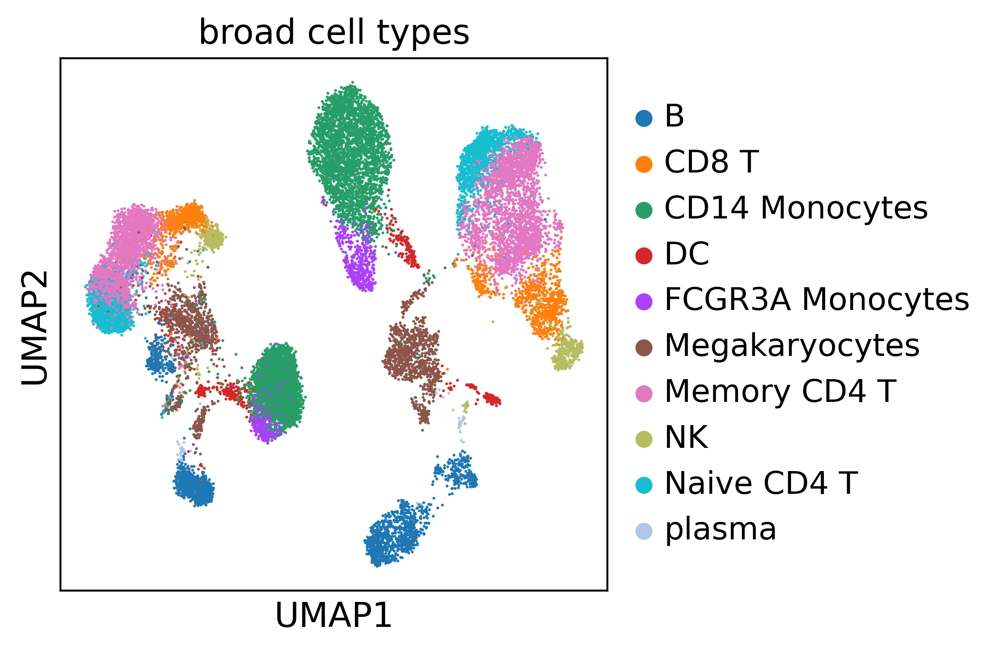

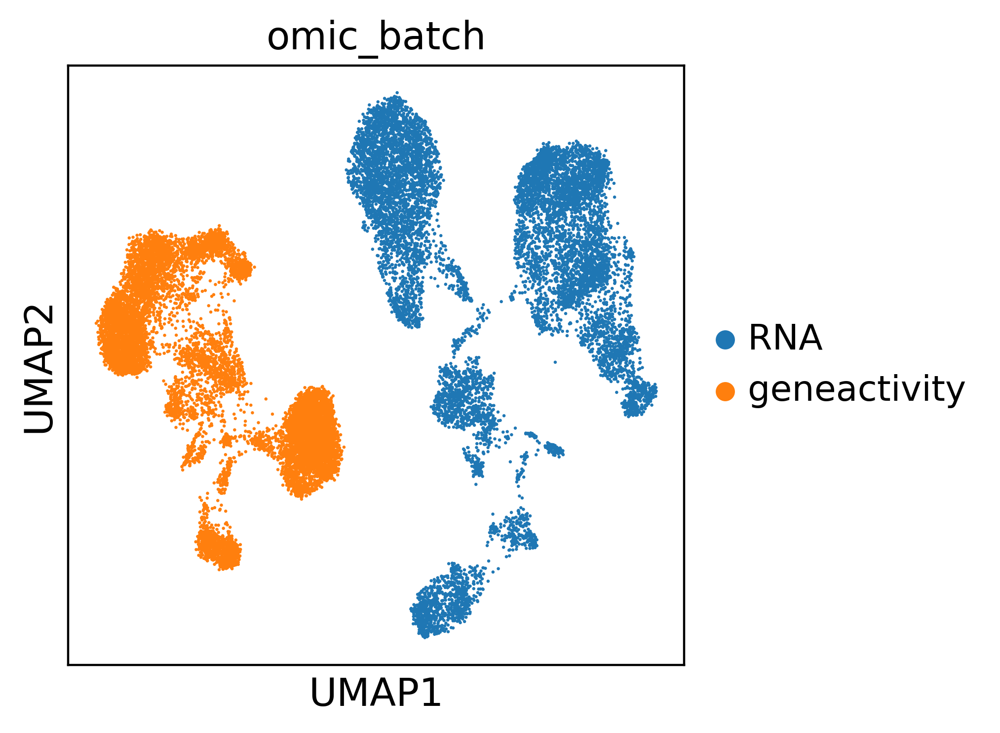

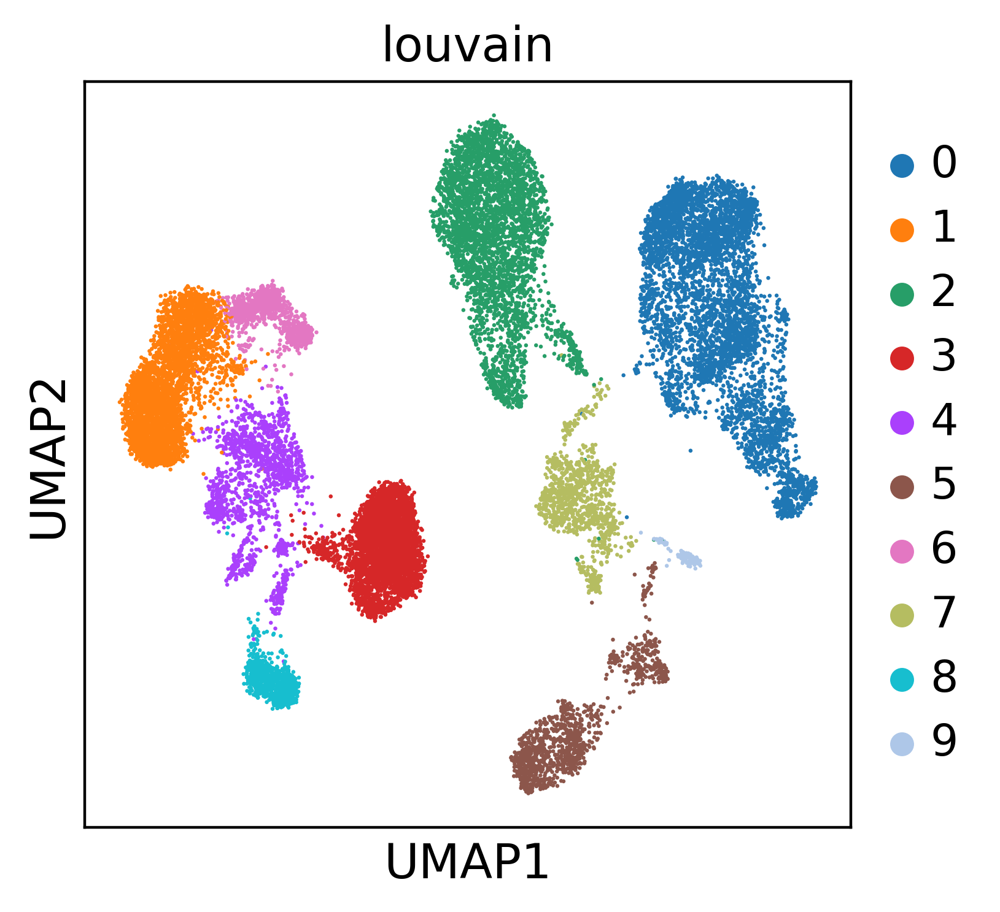

liger


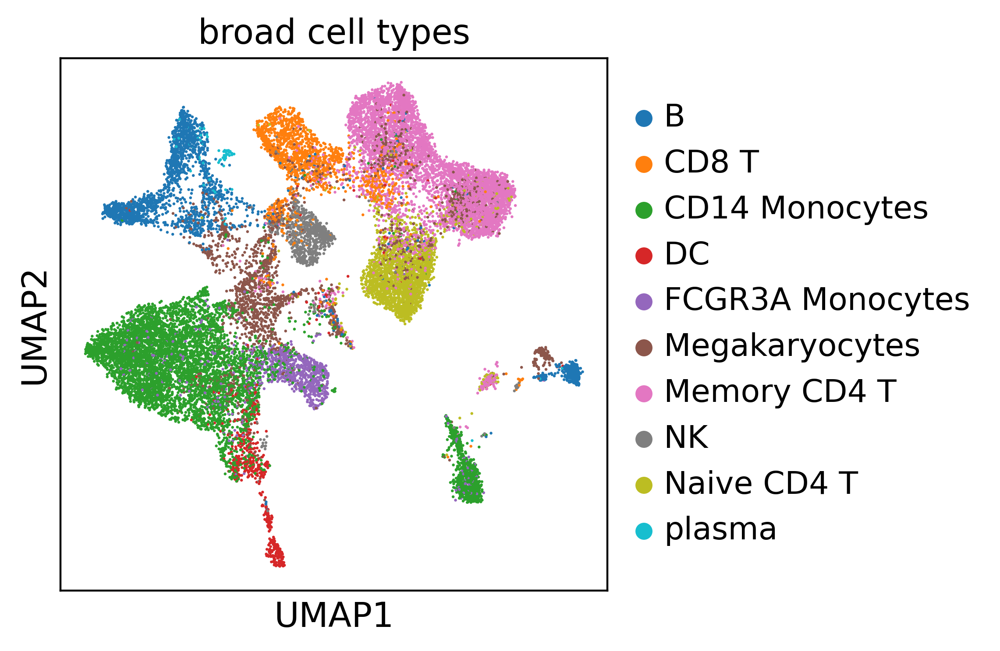

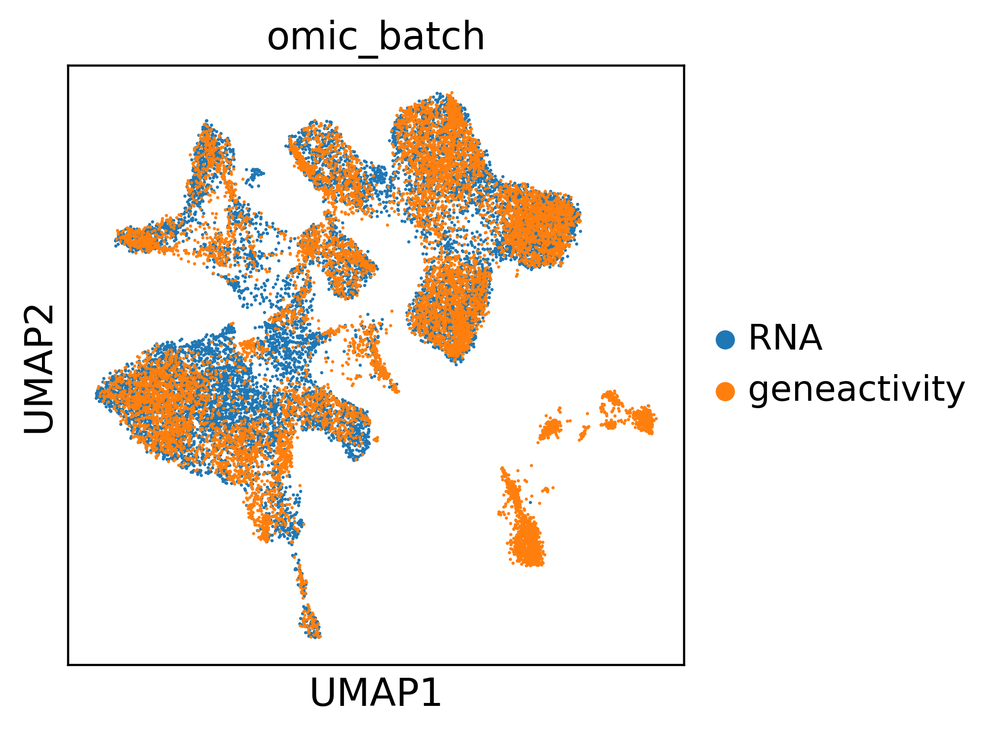

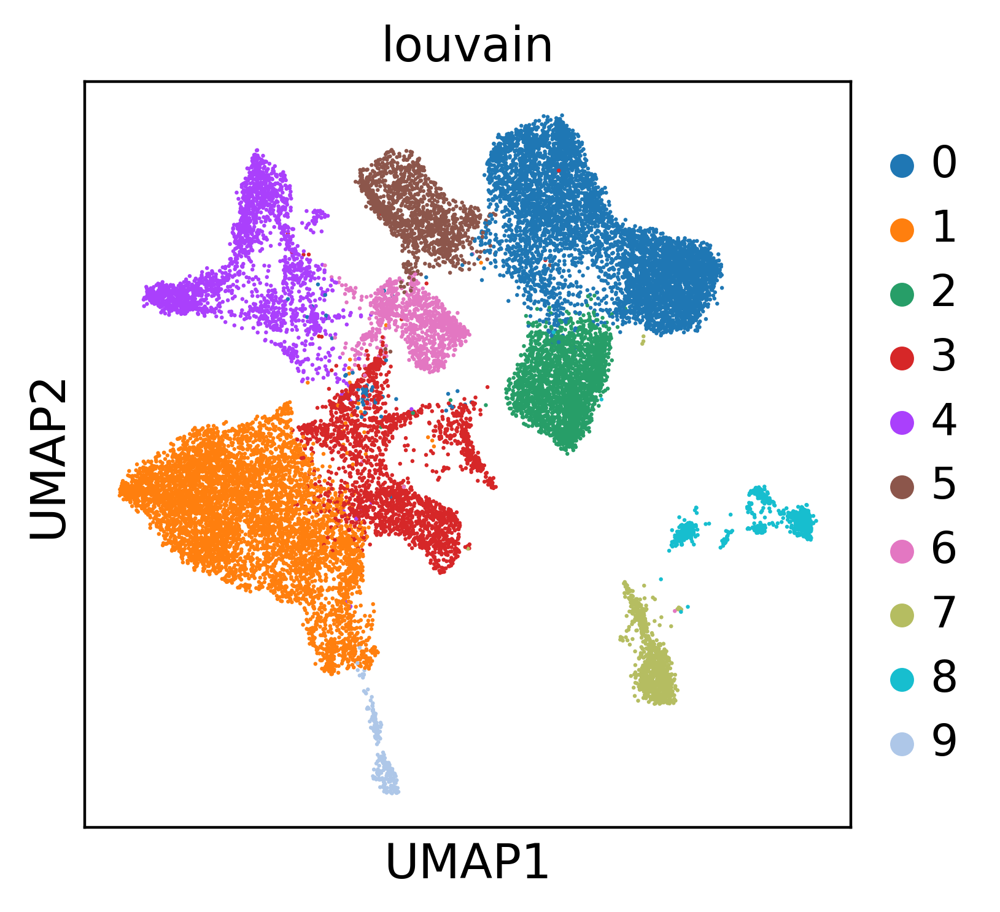

scjoint


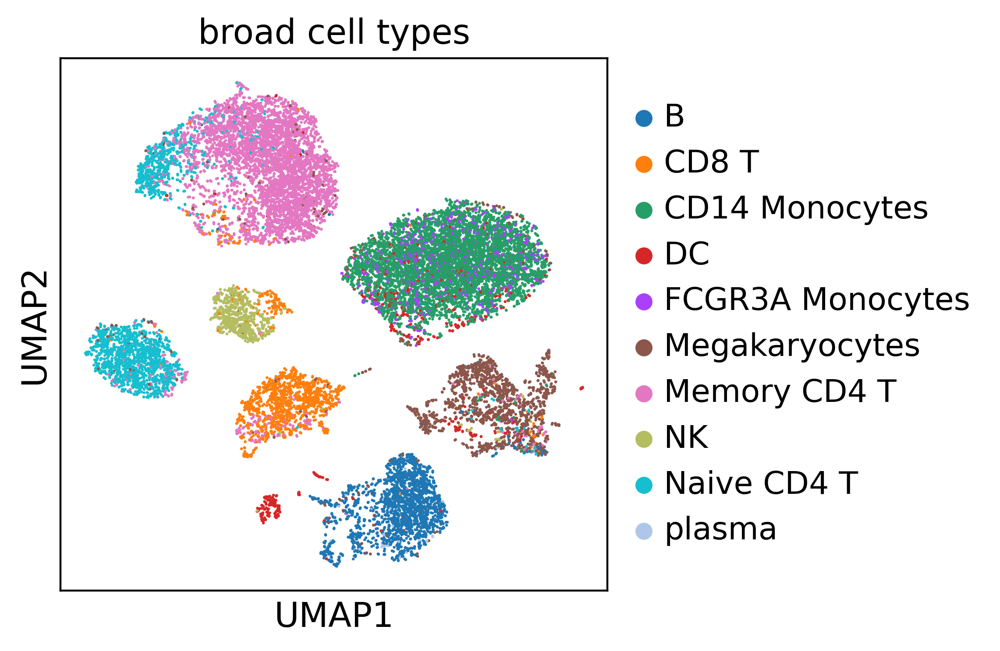

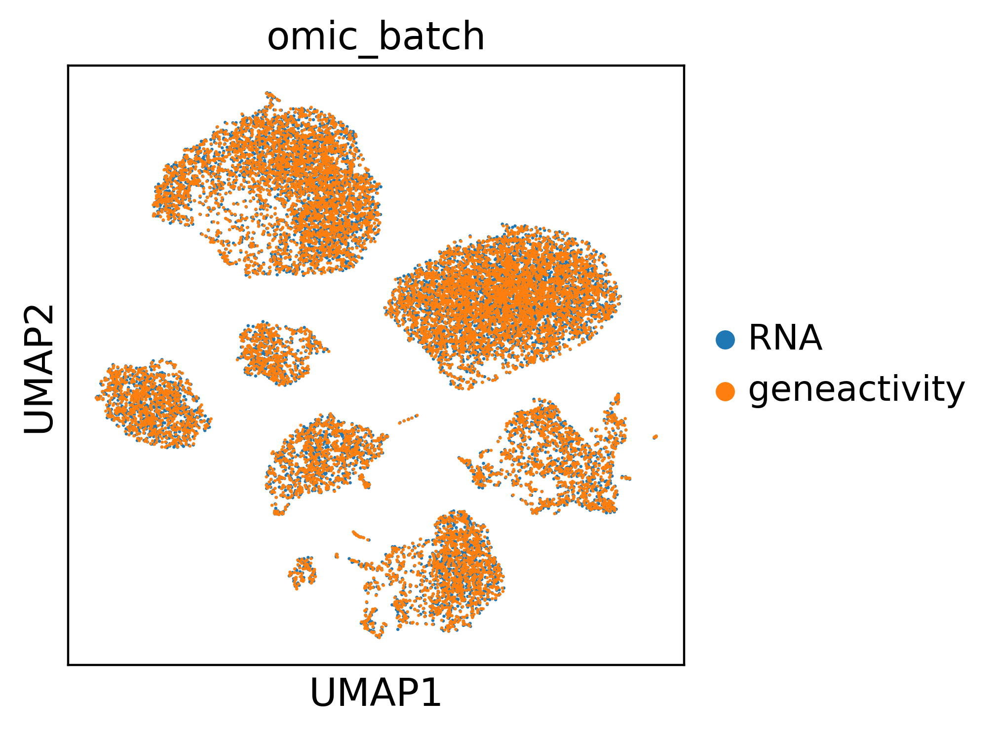

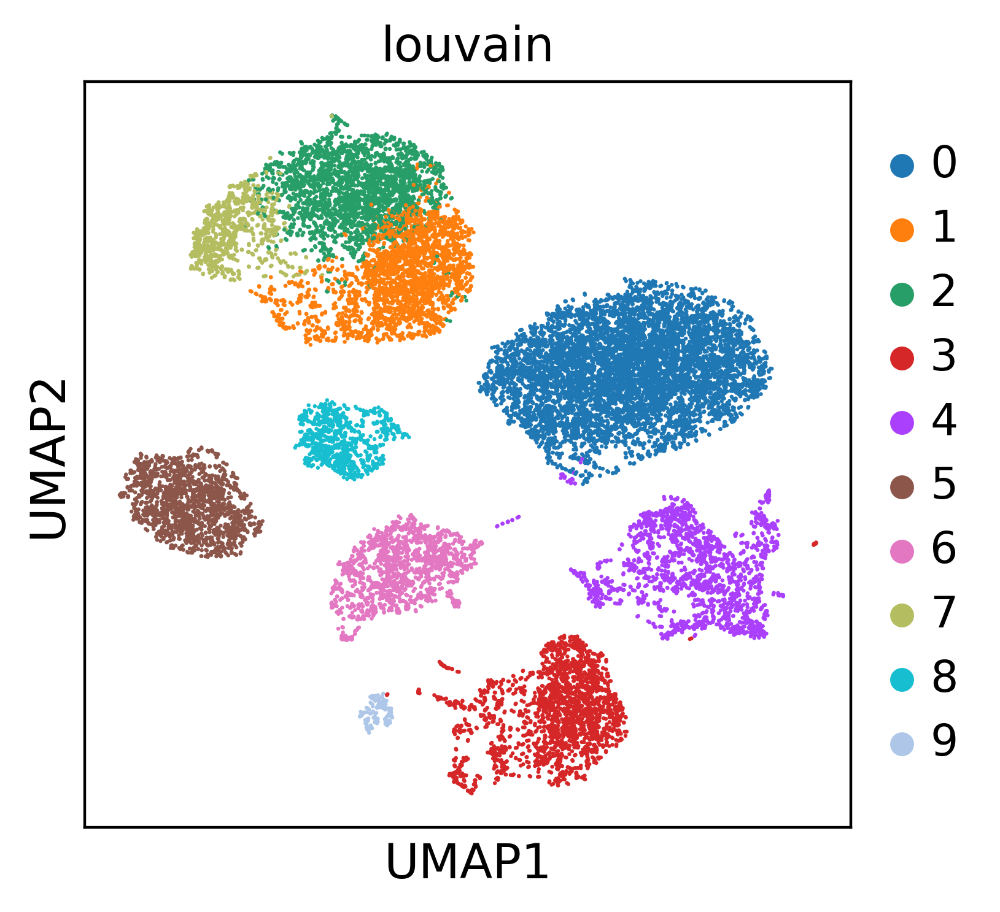

scot


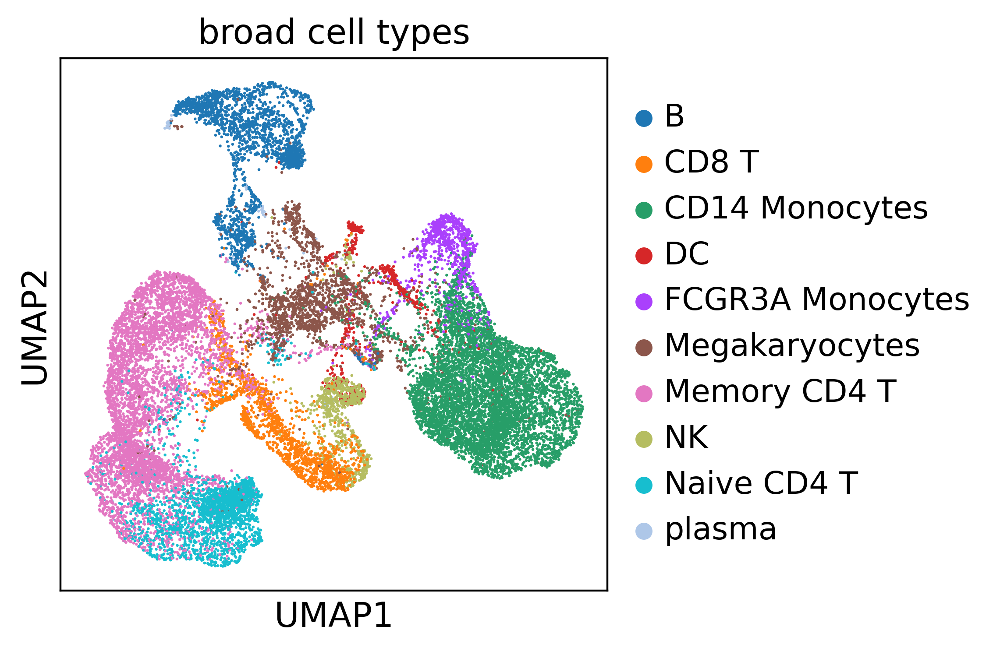

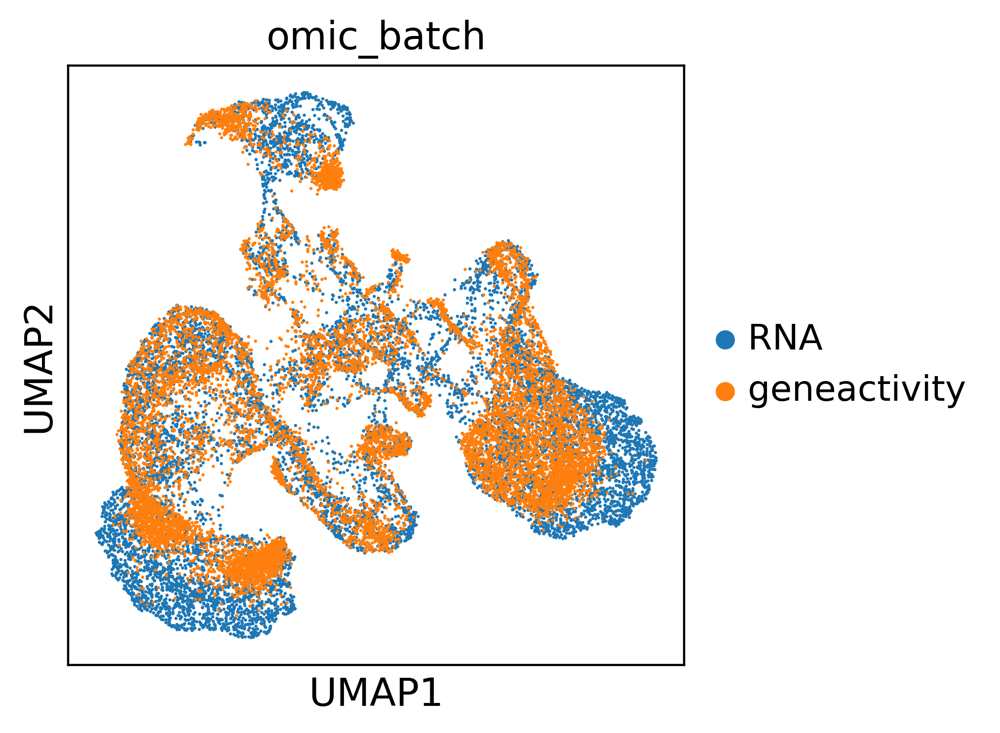

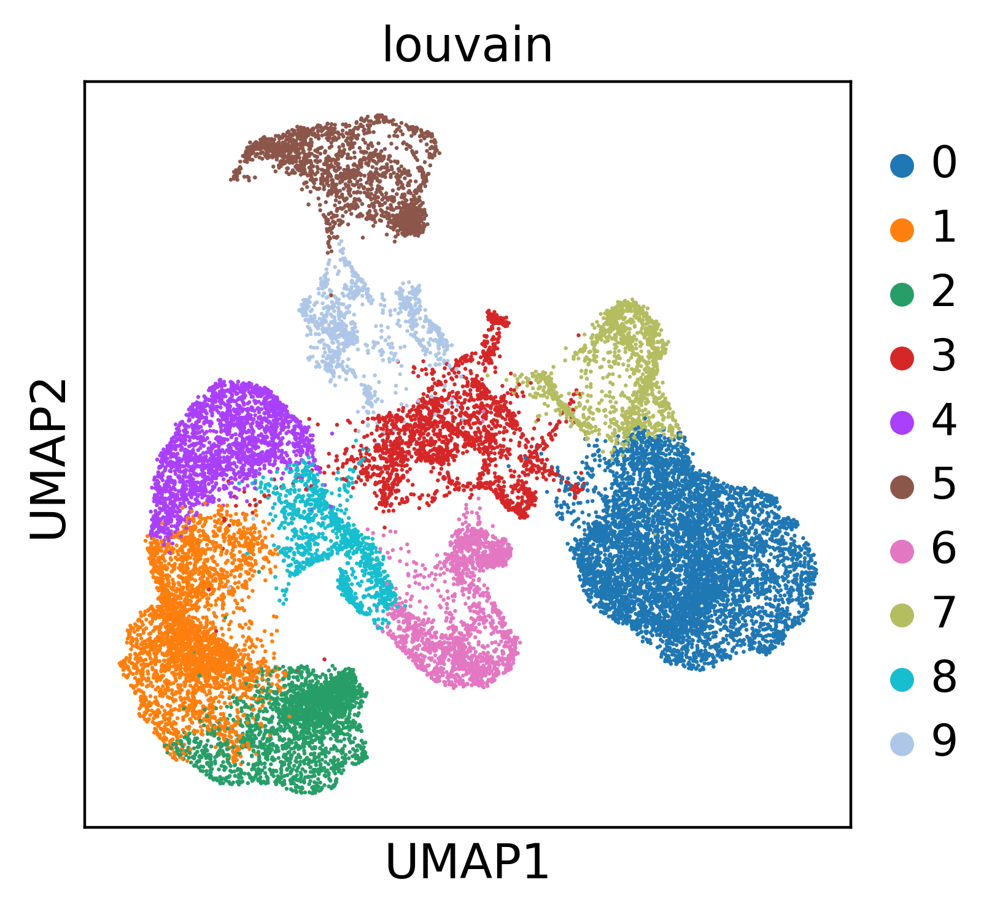

scalex


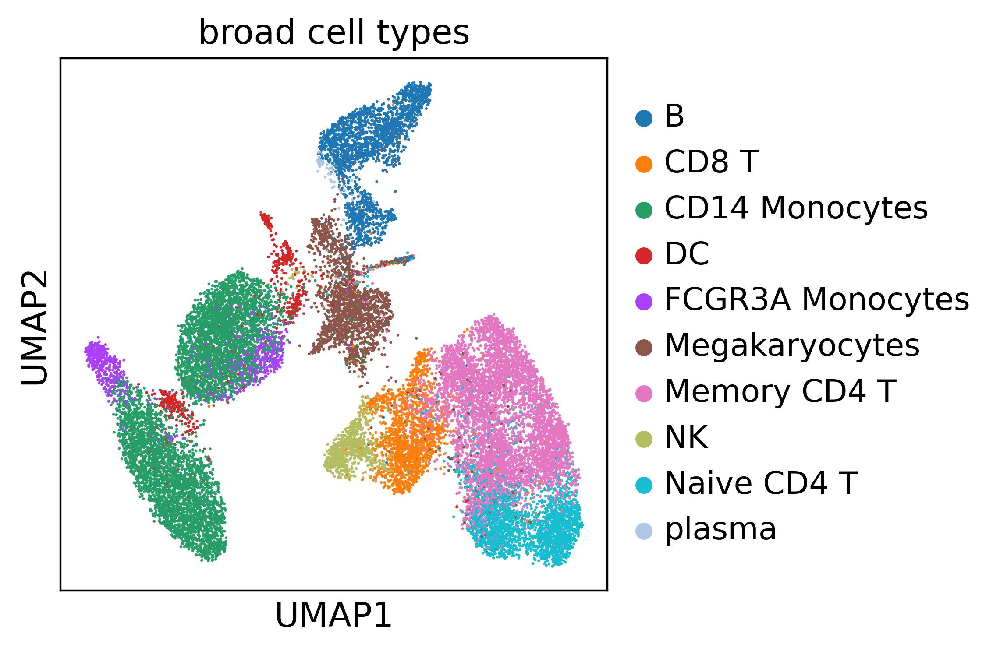

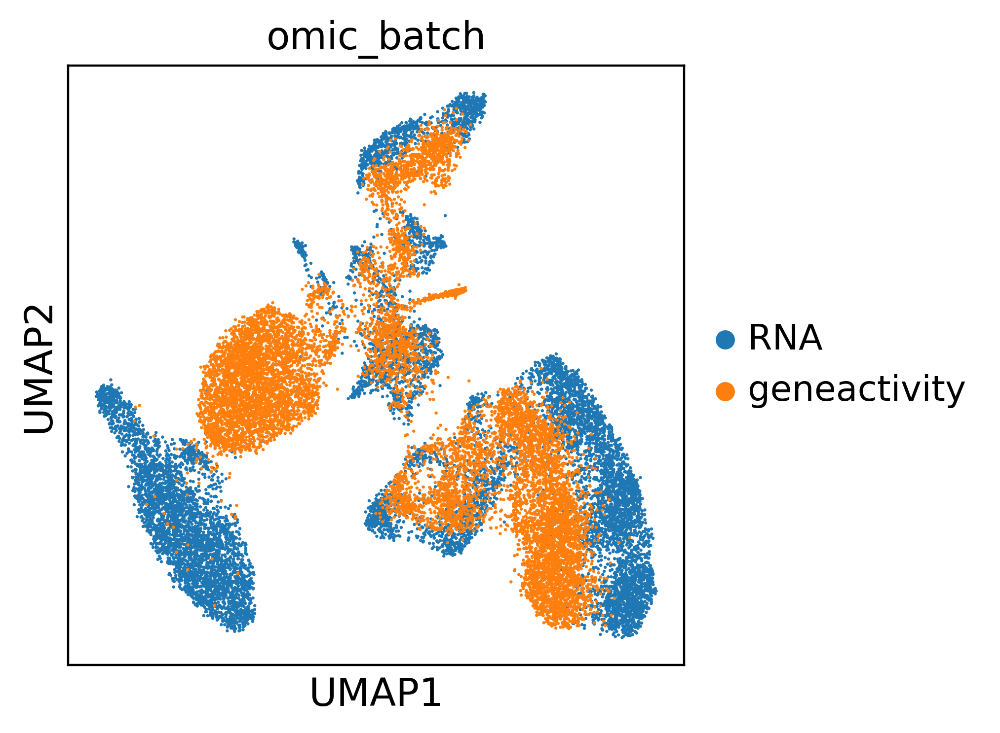

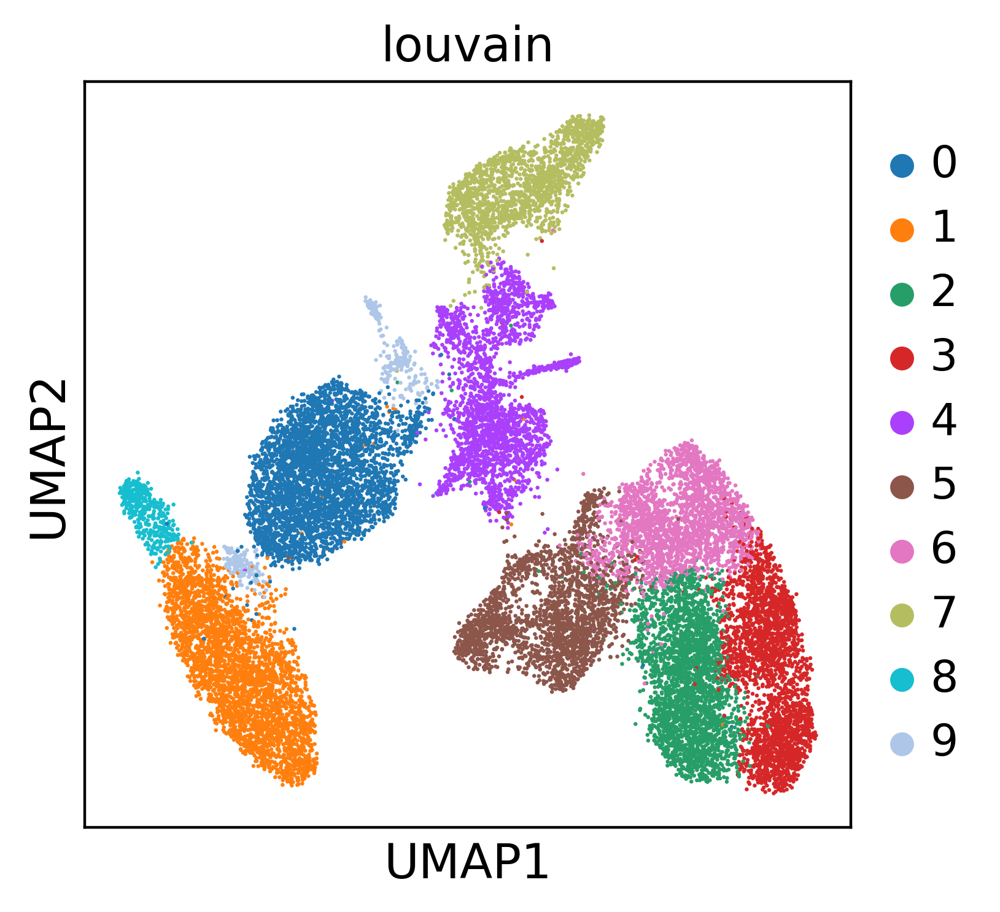

bindsc


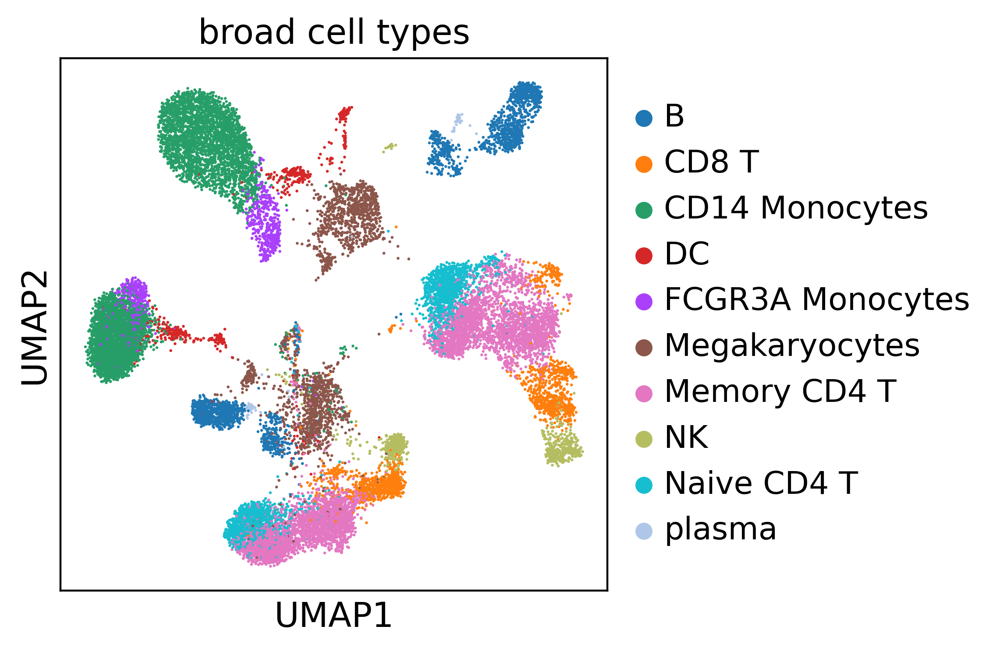

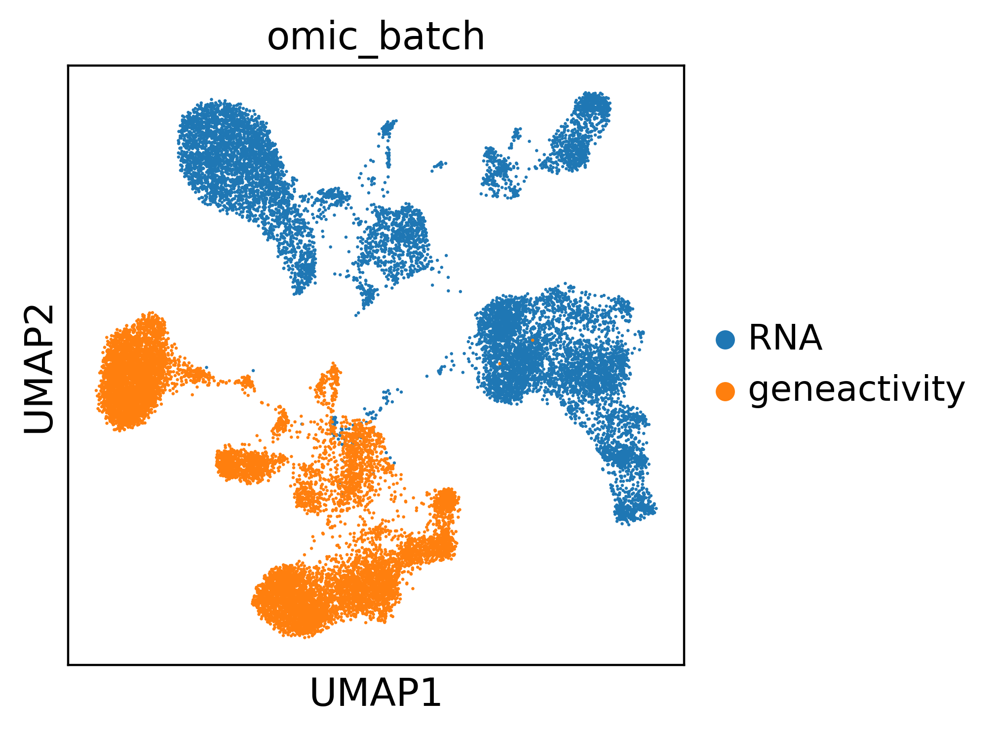

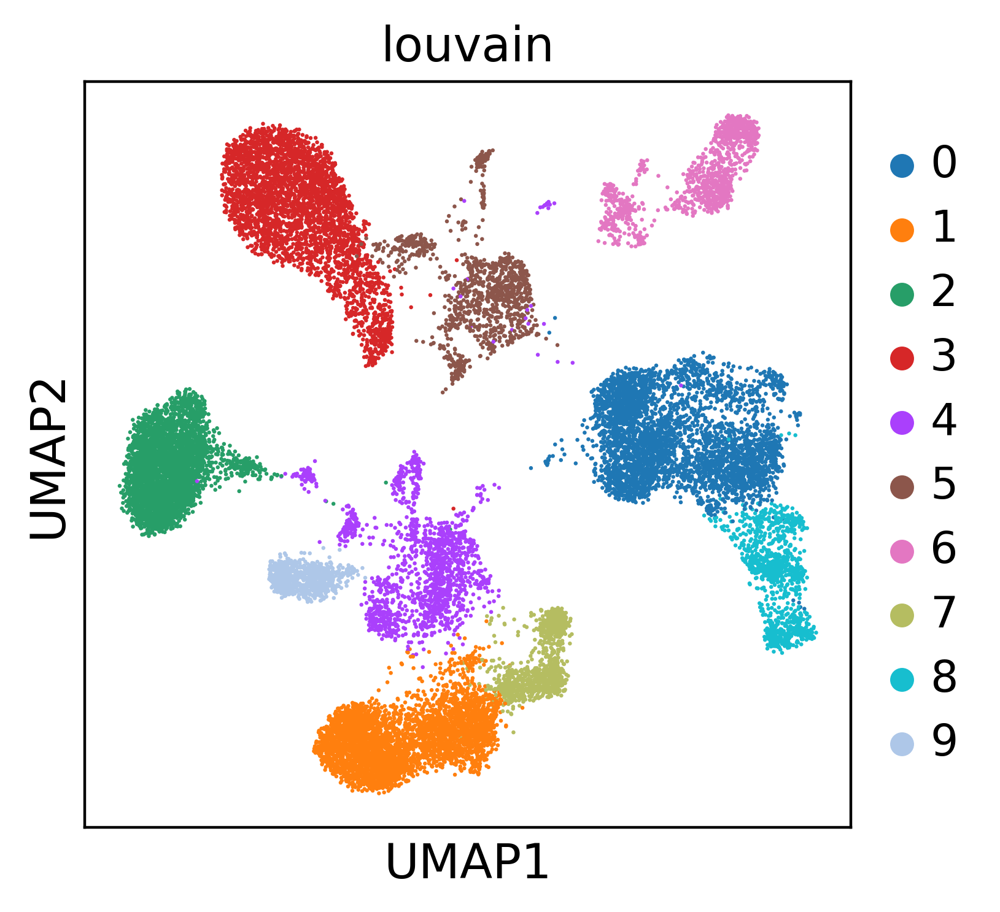

seurat_cca


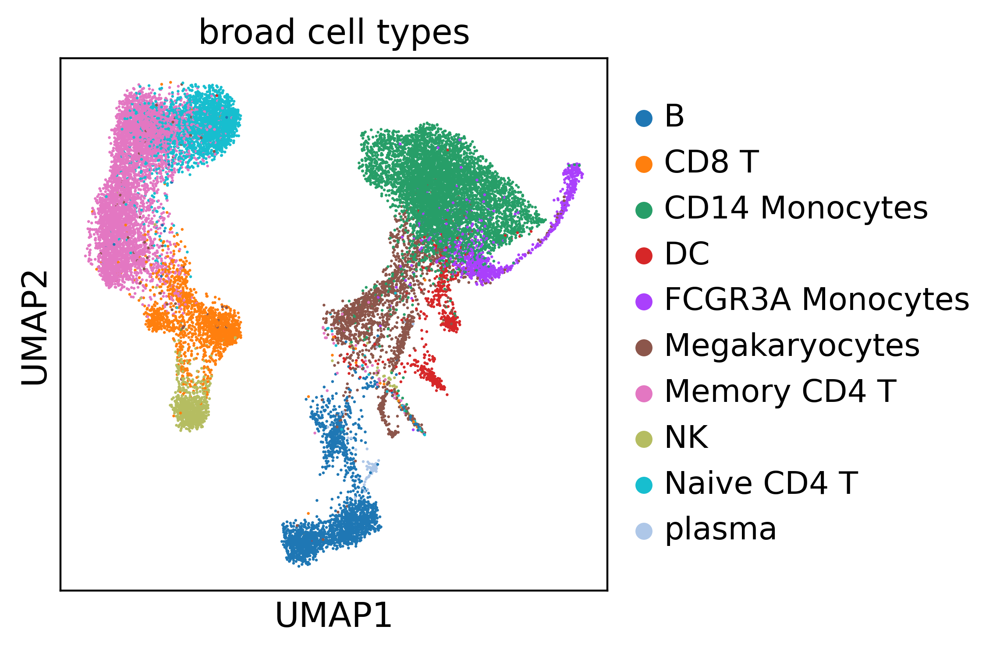

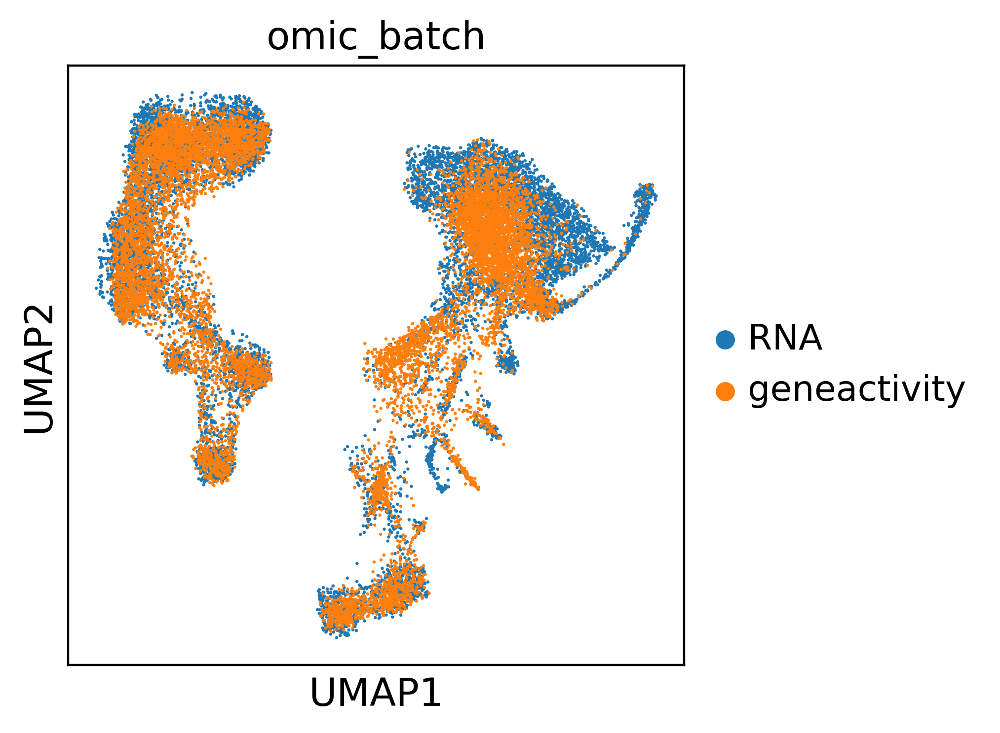

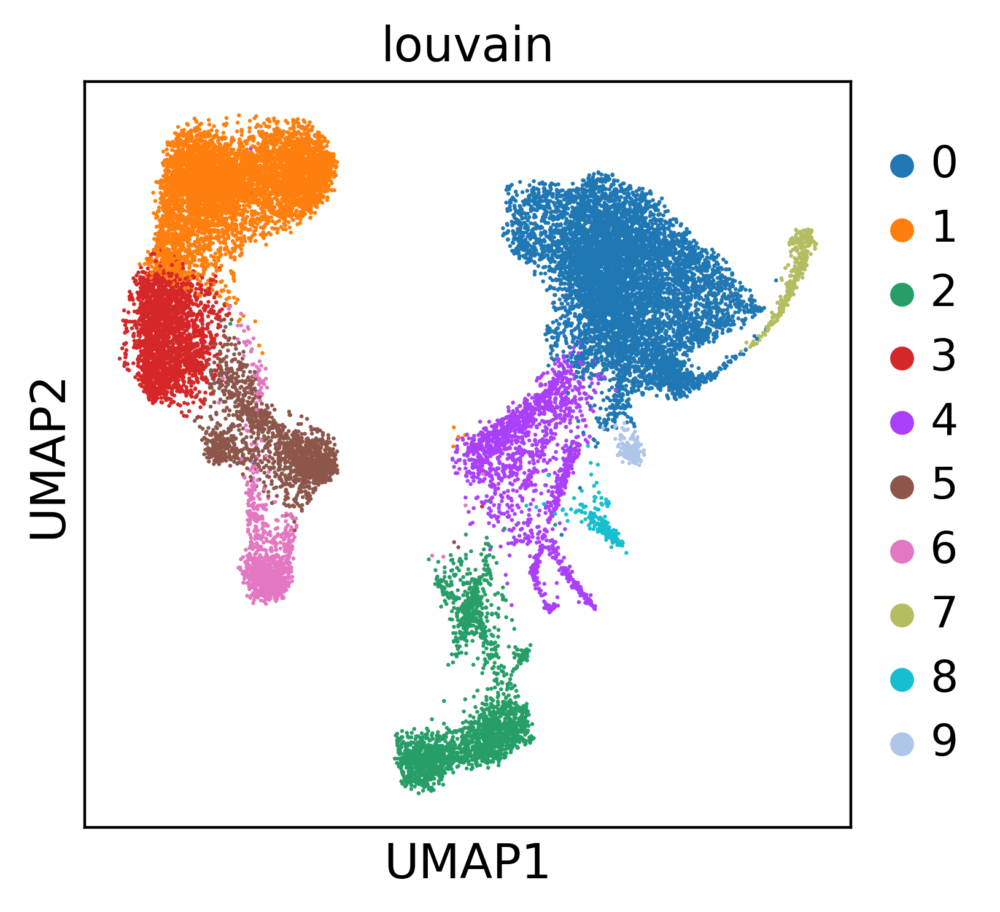

seurat_rpca


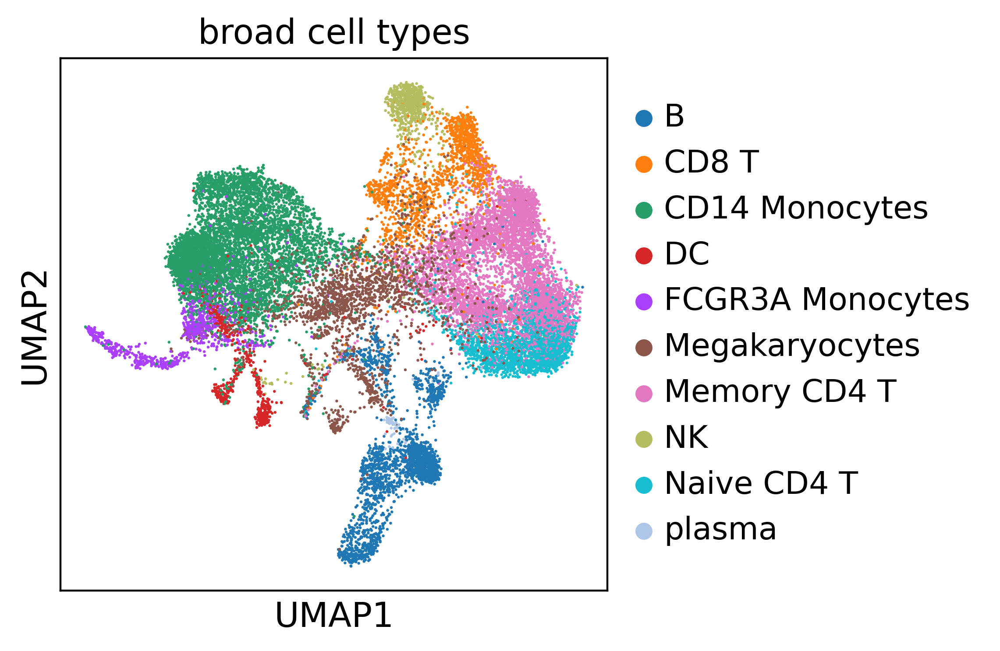

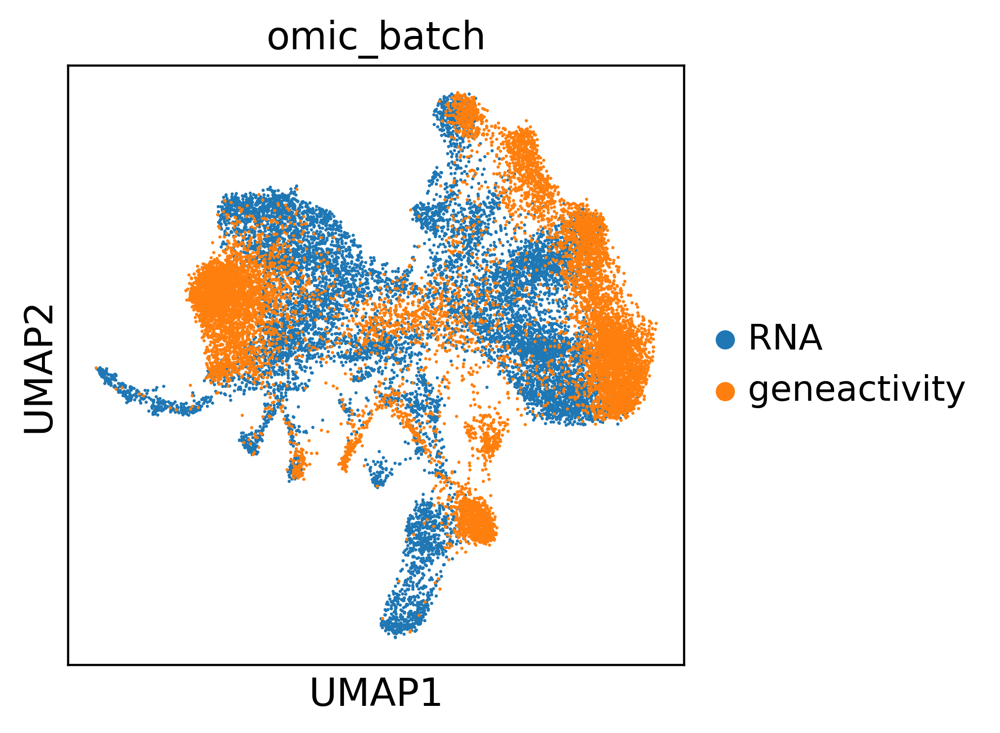

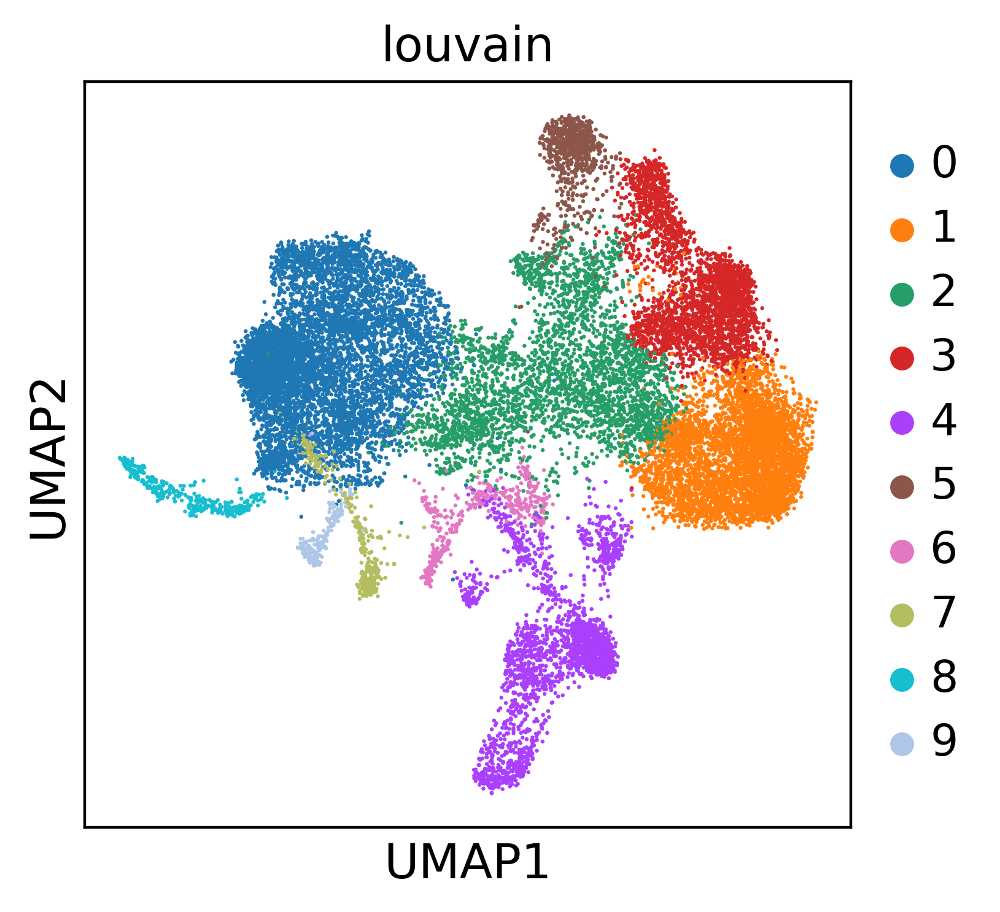

In [9]:
for i,j in zip(adata_list, ids):
    print(j)
    sc.pl.umap(i, color=['broad cell types'], wspace=0.7)
    sc.pl.umap(i, color=['omic_batch'], wspace=0.7)
    sc.pl.umap(i, color=['louvain'], wspace=0.7)
    

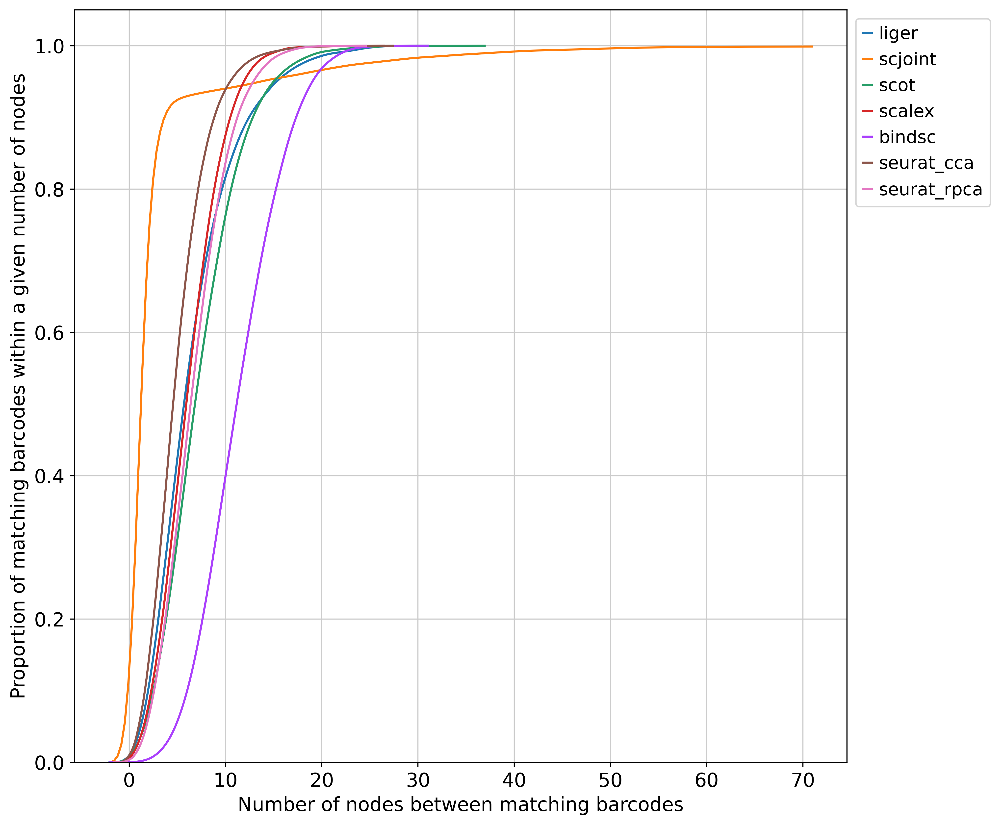

In [10]:
scmoib.pl.cumulative_node_group(adata_list[1:], ids[1:])

unintegrated


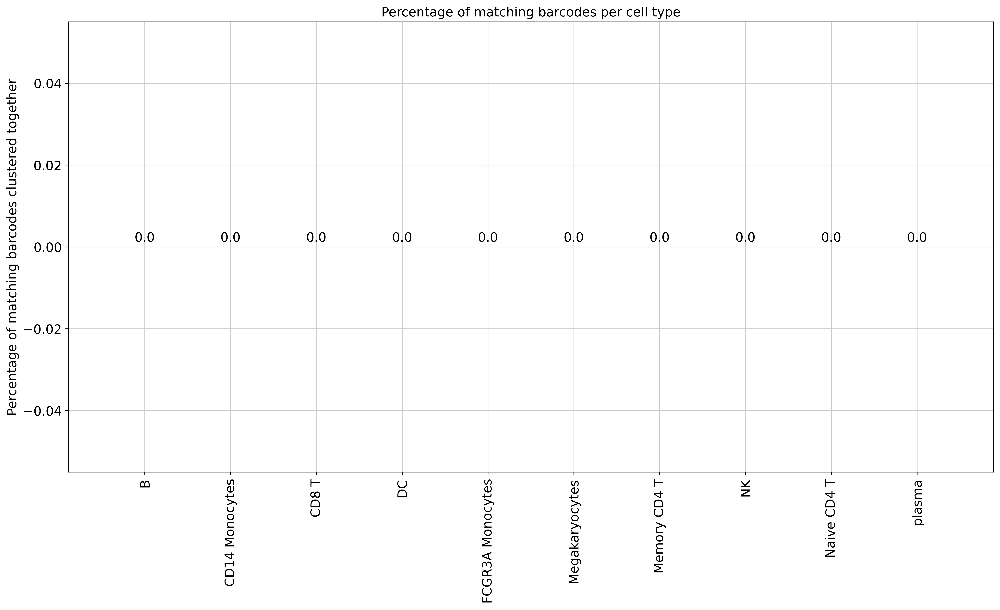

liger


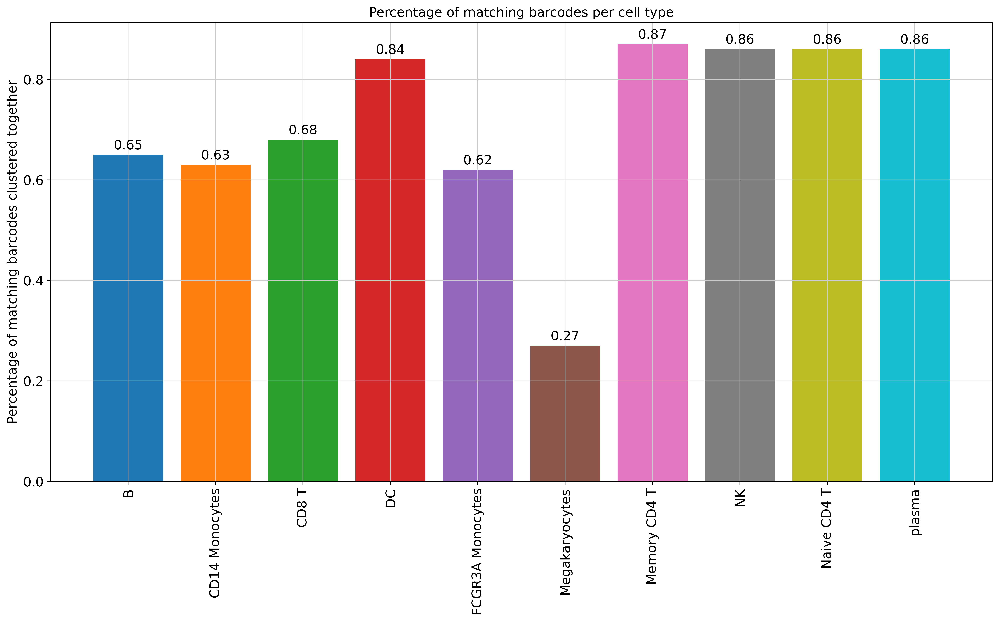

scjoint


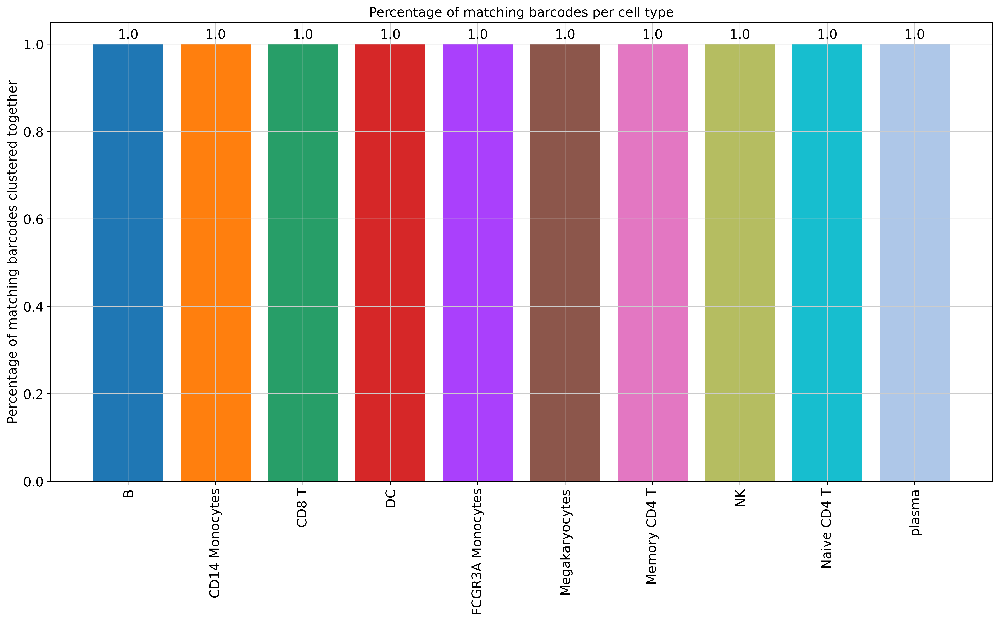

scot


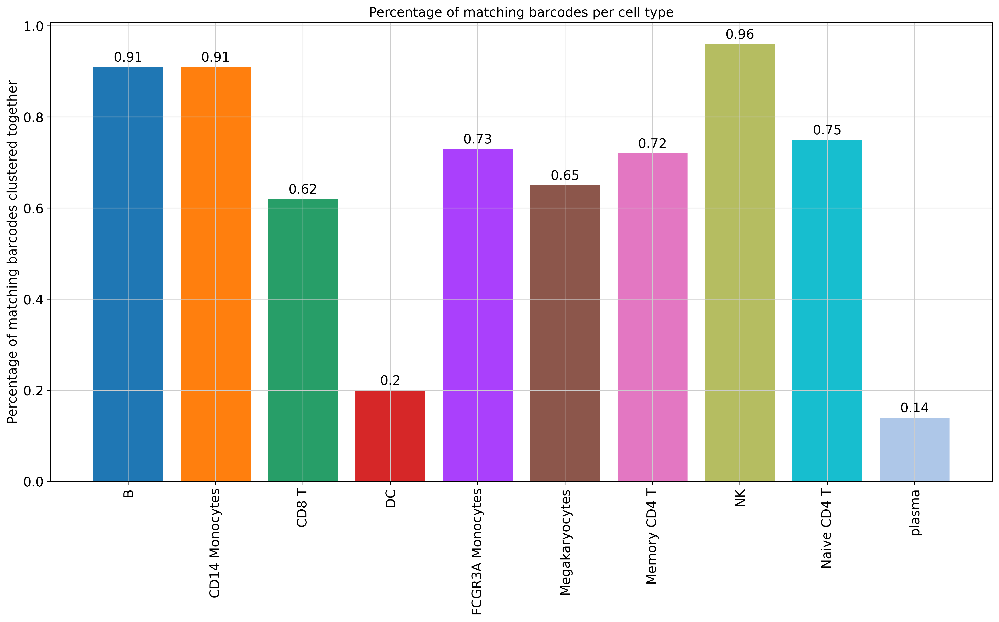

scalex


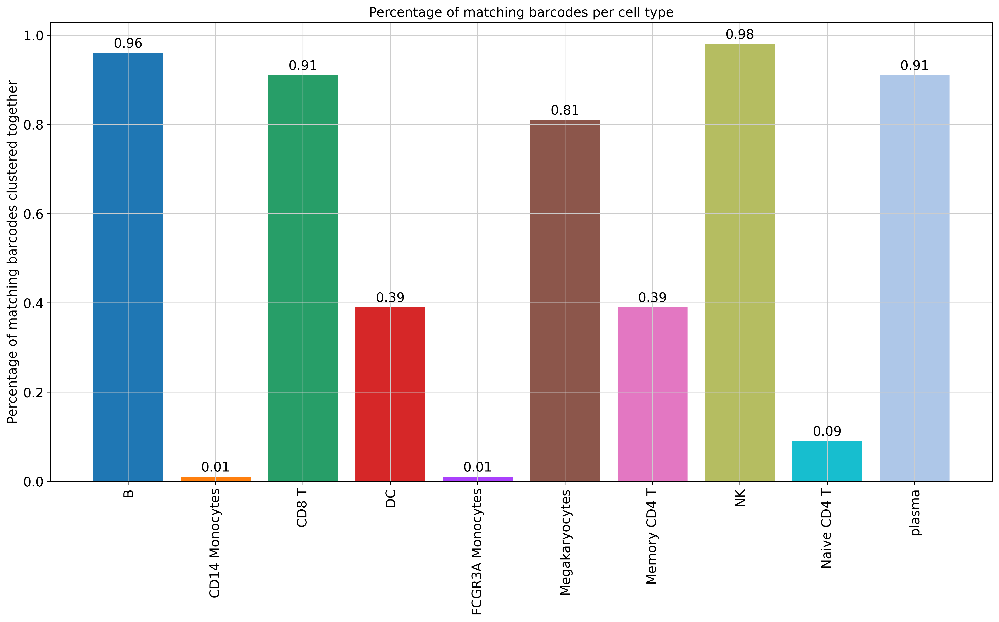

bindsc


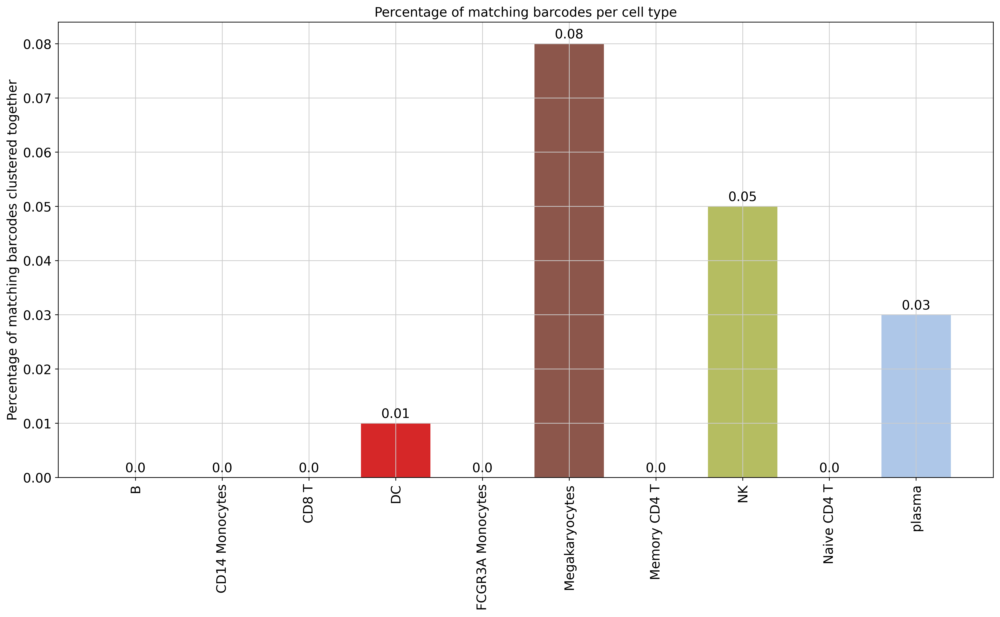

seurat_cca


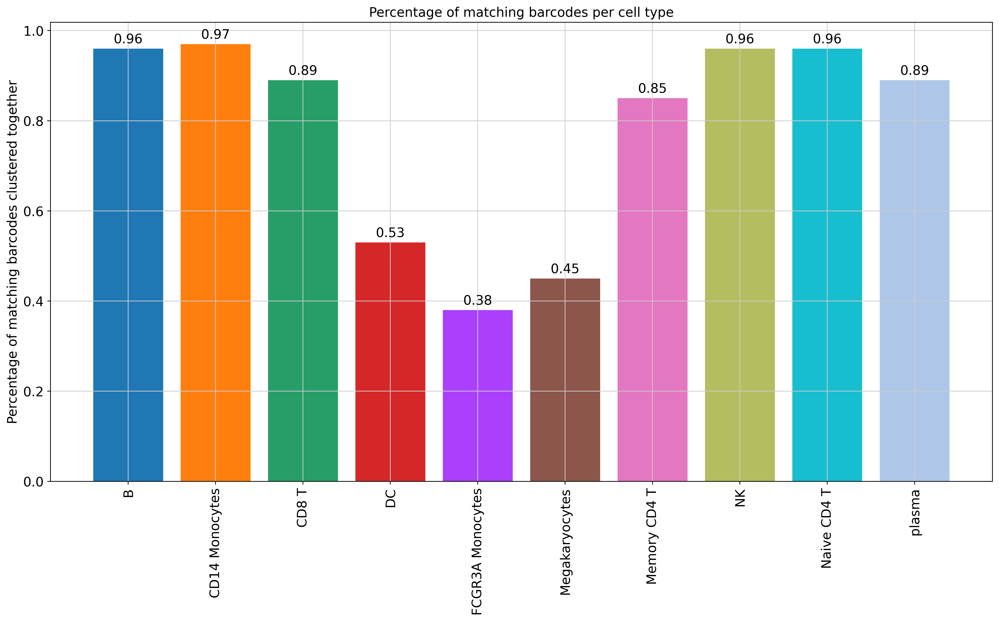

seurat_rpca


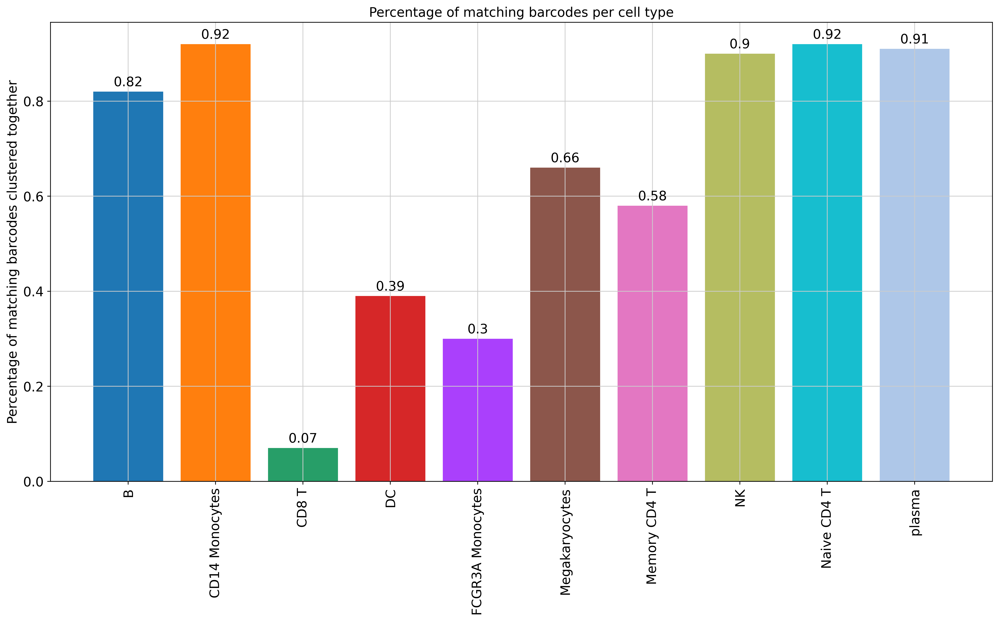

In [11]:
for i, j in zip(adata_list, ids):
    print(j)
    scmoib.pl.accuracy_per_cell_type(i, i.uns['acc_cell_type'], 'broad cell types')